In [1]:
import numpy as np
import pandas as pd

import matplotlib.pyplot as plt
import seaborn as sns

In [2]:
%matplotlib inline
sns.set()

In [3]:
SMALL_SIZE = 10
MEDIUM_SIZE = 14
BIGGER_SIZE = 18

plt.rc('font', size=BIGGER_SIZE)
plt.rc('axes', titlesize=BIGGER_SIZE)
plt.rc('axes', labelsize=BIGGER_SIZE)
plt.rc('xtick', labelsize=BIGGER_SIZE)
plt.rc('ytick', labelsize=BIGGER_SIZE)

# Загрузка данных

In [4]:
SOURCE = 'us_election16_data/'
county_facts = pd.read_csv(SOURCE + 'county_facts.csv')
county_facts_dict = pd.read_csv(SOURCE + 'county_facts_dictionary.csv')
county_facts_dict = dict(county_facts_dict.values)
primary_results = pd.read_csv(SOURCE + 'primary_results.csv')

# Обзор таблиц

Таблица со статистикой по округам

In [4]:
county_facts.head()

,fips,area_name,state_abbreviation,PST045214,PST040210,PST120214,POP010210,AGE135214,AGE295214,AGE775214,...,SBO415207,SBO015207,MAN450207,WTN220207,RTN130207,RTN131207,AFN120207,BPS030214,LND110210,POP060210
0,0,United States,NaN,318857056,308758105,3.3,308745538,6.2,23.1,14.5,...,8.3,28.8,5319456312,4174286516,3917663456,12990,613795732,1046363,3531905.43,87.4
1,1000,Alabama,NaN,4849377,4780127,1.4,4779736,6.1,22.8,15.3,...,1.2,28.1,112858843,52252752,57344851,12364,6426342,13369,50645.33,94.4
2,1001,Autauga County,AL,55395,54571,1.5,54571,6.0,25.2,13.8,...,0.7,31.7,0,0,598175,12003,88157,131,594.44,91.8
3,1003,Baldwin County,AL,200111,182265,9.8,182265,5.6,22.2,18.7,...,1.3,27.3,1410273,0,2966489,17166,436955,1384,1589.78,114.6
4,1005,Barbour County,AL,26887,27457,-2.1,27457,5.7,21.2,16.5,...,0.0,27.0,0,0,188337,6334,0,8,884.88,31.0


In [5]:
county_facts.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3195 entries, 0 to 3194
Data columns (total 54 columns):
fips                  3195 non-null int64
area_name             3195 non-null object
state_abbreviation    3143 non-null object
PST045214             3195 non-null int64
PST040210             3195 non-null int64
PST120214             3195 non-null float64
POP010210             3195 non-null int64
AGE135214             3195 non-null float64
AGE295214             3195 non-null float64
AGE775214             3195 non-null float64
SEX255214             3195 non-null float64
RHI125214             3195 non-null float64
RHI225214             3195 non-null float64
RHI325214             3195 non-null float64
RHI425214             3195 non-null float64
RHI525214             3195 non-null float64
RHI625214             3195 non-null float64
RHI725214             3195 non-null float64
RHI825214             3195 non-null float64
POP715213             3195 non-null float64
POP645213             3

In [6]:
county_facts.describe()

,fips,PST045214,PST040210,PST120214,POP010210,AGE135214,AGE295214,AGE775214,SEX255214,RHI125214,...,SBO415207,SBO015207,MAN450207,WTN220207,RTN130207,RTN131207,AFN120207,BPS030214,LND110210,POP060210
count,3195.000000,3.195000e+03,3.195000e+03,3195.000000,3.195000e+03,3195.000000,3195.000000,3195.000000,3195.000000,3195.000000,...,3195.000000,3195.000000,3.195000e+03,3.195000e+03,3.195000e+03,3195.000000,3.195000e+03,3.195000e+03,3.195000e+03,3195.000000
mean,30358.079499,2.993963e+05,2.899137e+05,0.508545,2.899019e+05,5.900782,22.545290,17.524632,49.913271,84.953271,...,1.735055,18.108169,4.732329e+06,3.804132e+06,3.677504e+06,10287.325196,5.739886e+05,9.823005e+02,3.316344e+03,261.265227
std,15181.225584,5.768468e+06,5.584181e+06,4.180066,5.583955e+06,1.211925,3.418896,4.433712,2.425066,16.290780,...,6.222794,12.809596,9.623516e+07,7.613666e+07,7.082882e+07,5409.442797,1.112830e+07,1.902455e+04,6.402903e+04,1718.802670
min,0.000000,0.000000e+00,0.000000e+00,-17.000000,8.200000e+01,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000,0.000000e+00,0.000000e+00,2.000000e+00,0.000000
25%,18172.000000,1.113450e+04,1.129500e+04,-1.900000,1.129500e+04,5.200000,20.500000,14.700000,49.500000,80.000000,...,0.000000,0.000000,0.000000e+00,0.000000e+00,7.818500e+04,6910.000000,6.240000e+03,6.000000e+00,4.325450e+02,17.150000
50%,29175.000000,2.655300e+04,2.644600e+04,-0.100000,2.642400e+04,5.800000,22.500000,17.200000,50.400000,91.900000,...,0.000000,23.400000,7.103000e+04,4.852600e+04,2.604220e+05,9806.000000,2.606300e+04,3.400000e+01,6.232800e+02,45.700000
75%,45076.000000,7.247600e+04,7.150450e+04,2.300000,7.144800e+04,6.500000,24.200000,19.800000,51.100000,95.900000,...,0.600000,27.800000,9.766630e+05,2.677625e+05,8.358655e+05,13002.500000,1.037800e+05,1.655000e+02,9.445850e+02,115.800000
max,56045.000000,3.188571e+08,3.087581e+08,72.900000,3.087455e+08,13.700000,42.000000,52.900000,56.800000,99.300000,...,78.000000,56.200000,5.319456e+09,4.174287e+09,3.917663e+09,80800.000000,6.137957e+08,1.046363e+06,3.531905e+06,69467.500000


Расшифровка названий столбцов

In [7]:
county_facts_dict

{'AFN120207': 'Accommodation and food services sales, 2007 ($1,000)',
 'AGE135214': 'Persons under 5 years, percent, 2014',
 'AGE295214': 'Persons under 18 years, percent, 2014',
 'AGE775214': 'Persons 65 years and over, percent, 2014',
 'BPS030214': 'Building permits, 2014',
 'BZA010213': 'Private nonfarm establishments, 2013',
 'BZA110213': 'Private nonfarm employment,  2013',
 'BZA115213': 'Private nonfarm employment, percent change, 2012-2013',
 'EDU635213': 'High school graduate or higher, percent of persons age 25+, 2009-2013',
 'EDU685213': "Bachelor's degree or higher, percent of persons age 25+, 2009-2013",
 'HSD310213': 'Persons per household, 2009-2013',
 'HSD410213': 'Households, 2009-2013',
 'HSG010214': 'Housing units, 2014',
 'HSG096213': 'Housing units in multi-unit structures, percent, 2009-2013',
 'HSG445213': 'Homeownership rate, 2009-2013',
 'HSG495213': 'Median value of owner-occupied housing units, 2009-2013',
 'INC110213': 'Median household income, 2009-2013',
 '

Таблица с результатами праймериз (выбор единого кандидата от каждой партии)

In [8]:
primary_results.head()

,state,state_abbreviation,county,fips,party,candidate,votes,fraction_votes
0,Alabama,AL,Autauga,1001.0,Democrat,Bernie Sanders,544,0.182
1,Alabama,AL,Autauga,1001.0,Democrat,Hillary Clinton,2387,0.800
2,Alabama,AL,Baldwin,1003.0,Democrat,Bernie Sanders,2694,0.329
3,Alabama,AL,Baldwin,1003.0,Democrat,Hillary Clinton,5290,0.647
4,Alabama,AL,Barbour,1005.0,Democrat,Bernie Sanders,222,0.078


In [8]:
primary_results.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 24611 entries, 0 to 24610
Data columns (total 8 columns):
state                 24611 non-null object
state_abbreviation    24611 non-null object
county                24611 non-null object
fips                  24511 non-null float64
party                 24611 non-null object
candidate             24611 non-null object
votes                 24611 non-null int64
fraction_votes        24611 non-null float64
dtypes: float64(2), int64(1), object(5)
memory usage: 1.5+ MB


In [9]:
primary_results.describe()

,fips,votes,fraction_votes
count,2.451100e+04,24611.000000,24611.000000
mean,2.667152e+07,2306.252773,0.304524
std,4.200978e+07,9861.183572,0.231401
min,1.001000e+03,0.000000,0.000000
25%,2.109100e+04,68.000000,0.094000
50%,4.208100e+04,358.000000,0.273000
75%,9.090012e+07,1375.000000,0.479000
max,9.560004e+07,590502.000000,1.000000


# Подготовка таблицы

Объединим таблицы. Нас будут интересовать праймериз в Демократической партии.

In [4]:
county_facts = county_facts.rename(columns={'area_name': 'county'})
county_facts['county'] = county_facts.county.map(lambda x: x.replace(' County', ''))

max_votes = primary_results\
    .loc[primary_results['party'] == 'Democrat', ['state_abbreviation', 'county', 'votes', 'fraction_votes']]\
    .groupby(by=['state_abbreviation', 'county'])\
    .agg(np.max)\
    .reset_index()
data = pd.merge(
    primary_results.loc[primary_results['party'] == 'Democrat', ['state_abbreviation', 'county', 'candidate', 'votes']], 
    max_votes, 
    on=['state_abbreviation', 'county', 'votes'])

data = pd.merge(
    data,
    county_facts,
    on=['state_abbreviation', 'county'])

# данные по стране
total = county_facts.iloc[0].copy()

Признаки, данные в абсолютных значениях, нормализуем на население округа.

In [5]:
abs_norm_feature_names = [
    'VET605213',
    'BZA010213',
    'BZA110213',
    'SBO001207',
    'MAN450207',
    'WTN220207',
    'AFN120207',
    'BPS030214',
    'HSG010214',
    'HSG495213',
    'HSD410213',
    'NES010213',
    'votes'
]
abs_feature_names = abs_norm_feature_names + [
    'LND110210',
    'POP060210',
    'RTN130207'
]

In [6]:
for feature_name in abs_norm_feature_names:
    data[feature_name + '/PST045214'] = data[feature_name] / data['PST045214']
    if feature_name != 'votes':
        total[feature_name + '/PST045214'] = total[feature_name] / total['PST045214']
    county_facts_dict[feature_name + '/PST045214'] = county_facts_dict.get(feature_name, feature_name) + ' / population'
abs_feature_names.append('PST045214')

data['EDU635213-EDU685213'] = data['EDU635213'] - data['EDU685213']
total['EDU635213-EDU685213'] = total['EDU635213'] - total['EDU685213']
county_facts_dict['EDU635213-EDU685213'] = 'Only High school graduate'

Выбросим лишние столбцы

In [7]:
drop_features = [
    'state_abbreviation',
    'county',
    'fips',
    'POP010210',
    'PST040210'
]
data = data.drop(columns=drop_features, errors='ignore')
total = total.drop(labels=drop_features, errors='ignore')

for feature_name in drop_features:
    county_facts_dict.pop(feature_name, None)

In [8]:
data.head()

,candidate,votes,fraction_votes,PST045214,PST120214,AGE135214,AGE295214,AGE775214,SEX255214,RHI125214,...,MAN450207/PST045214,WTN220207/PST045214,AFN120207/PST045214,BPS030214/PST045214,HSG010214/PST045214,HSG495213/PST045214,HSD410213/PST045214,NES010213/PST045214,votes/PST045214,EDU635213-EDU685213
0,Hillary Clinton,2387,0.800,55395,1.5,6.0,25.2,13.8,51.4,77.9,...,0.000000,0.0,1.591425,0.002365,0.410705,2.458706,0.362325,0.053200,0.043091,64.7
1,Hillary Clinton,5290,0.647,200111,9.8,5.6,22.2,18.7,51.2,87.1,...,7.047454,0.0,2.183563,0.006916,0.536572,0.842532,0.366212,0.082494,0.026435,61.4
2,Hillary Clinton,2567,0.906,26887,-2.1,5.7,21.2,16.5,46.6,50.2,...,0.000000,0.0,0.000000,0.000298,0.438837,3.317588,0.342173,0.057500,0.095474,60.3
3,Hillary Clinton,942,0.755,22506,-1.8,5.3,21.0,14.8,45.9,76.3,...,0.000000,0.0,0.477961,0.000844,0.398916,4.021150,0.315072,0.050031,0.041856,65.4
4,Hillary Clinton,564,0.551,57719,0.7,6.1,23.6,17.0,50.5,96.0,...,5.917358,0.0,0.362809,0.000052,0.412793,2.028795,0.365703,0.061730,0.009771,64.9


In [10]:
total.head(), total.tail()

(PST045214    318857056
 PST120214          3.3
 AGE135214          6.2
 AGE295214         23.1
 AGE775214         14.5
 Name: 0, dtype: object, HSG010214/PST045214/log   -0.843699
 HSG495213/PST045214/log    -4.55123
 HSD410213/PST045214/log   -0.987312
 NES010213/PST045214/log    -2.49921
 EDU635213-EDU685213/log     4.04673
 Name: 0, dtype: object)

# Результаты голосования

In [11]:
np.unique(data['candidate'].values, return_counts=True)

(array(['Bernie Sanders', 'Hillary Clinton'], dtype=object),
 array([1187, 1568], dtype=int64))

In [12]:
data.loc[data['candidate'] == 'Hillary Clinton', 'votes'].sum()

10761601

In [13]:
data.loc[data['candidate'] == 'Bernie Sanders', 'votes'].sum()

3400455

# Распределения отдельных признаков

Отберем топ-N признаков разными способами

 ## Посчитаем корреляции

In [47]:
SMALL_SIZE = 10
MEDIUM_SIZE = 14
BIGGER_SIZE = 18

plt.rc('font', size=MEDIUM_SIZE)
plt.rc('axes', titlesize=MEDIUM_SIZE)
plt.rc('axes', labelsize=MEDIUM_SIZE)
plt.rc('xtick', labelsize=MEDIUM_SIZE)
plt.rc('ytick', labelsize=MEDIUM_SIZE)

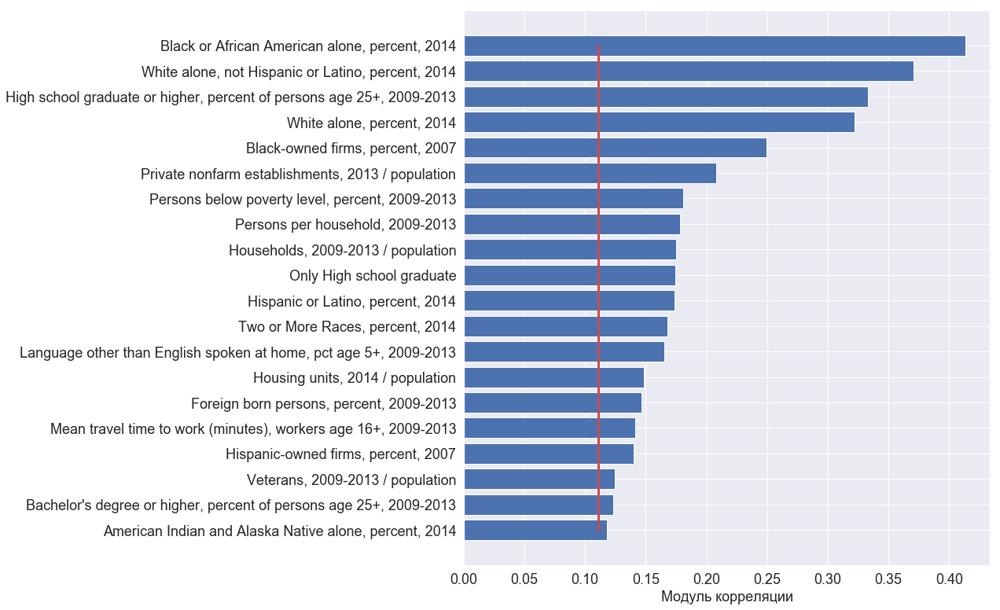

In [76]:
corr = data[data.keys()[3:]].corrwith(data['candidate'].map(lambda x: float(x == 'Hillary Clinton')))
indices = np.argsort(np.abs(corr.values))[::-1]
plt.figure(figsize=(12, 13))
topN = 20
plt.barh(np.arange(topN), np.abs(corr[indices[topN - 1::-1]]))
plt.plot([np.mean(np.abs(corr.values))] * topN, np.arange(topN), c='r', linewidth=3)
plt.yticks(np.arange(topN), [county_facts_dict.get(key, key) for key in corr.keys()[indices[topN - 1::-1]]])
plt.xlabel('Модуль корреляции')
plt.show()

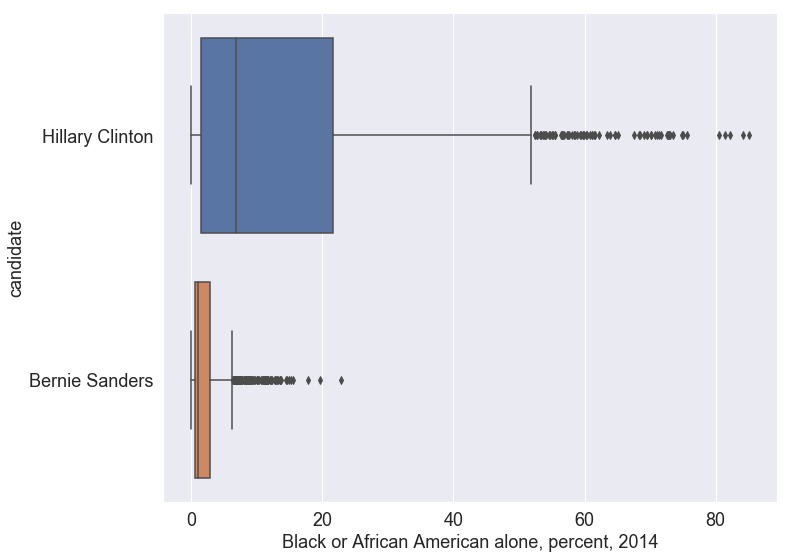

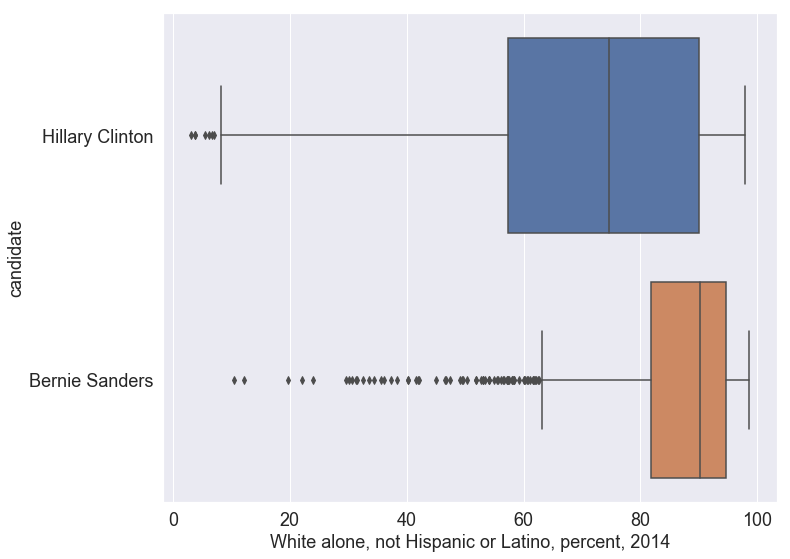

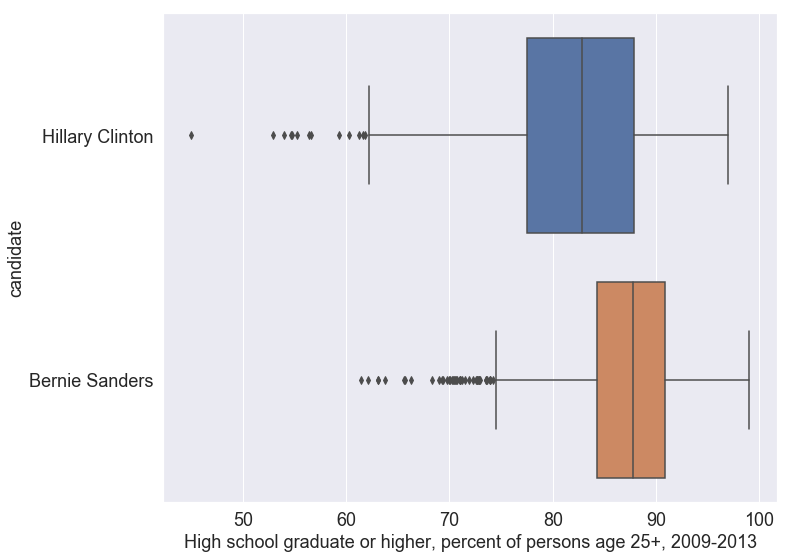

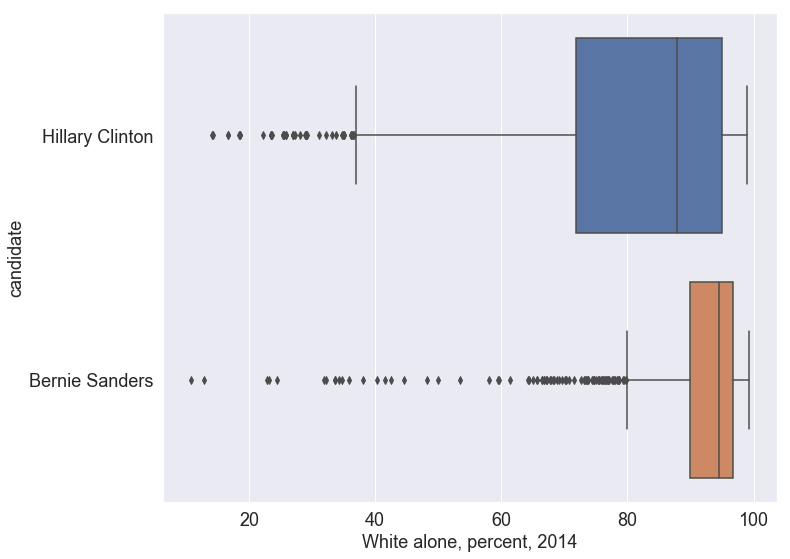

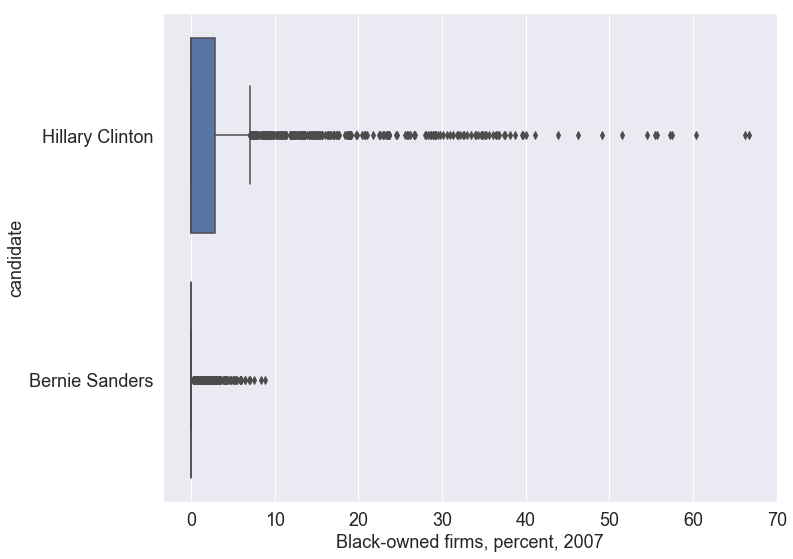

...

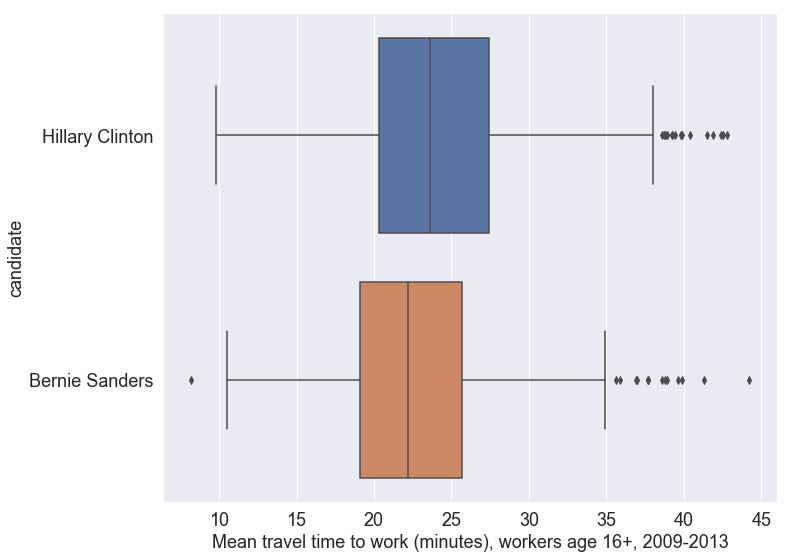

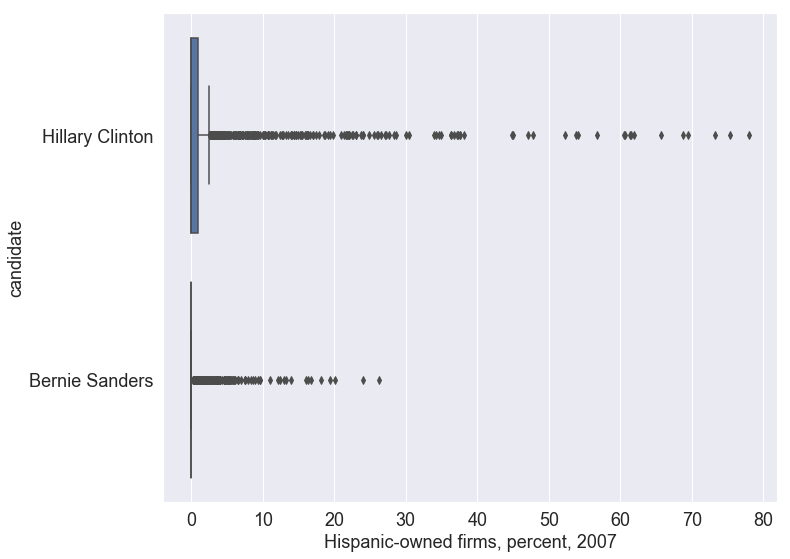

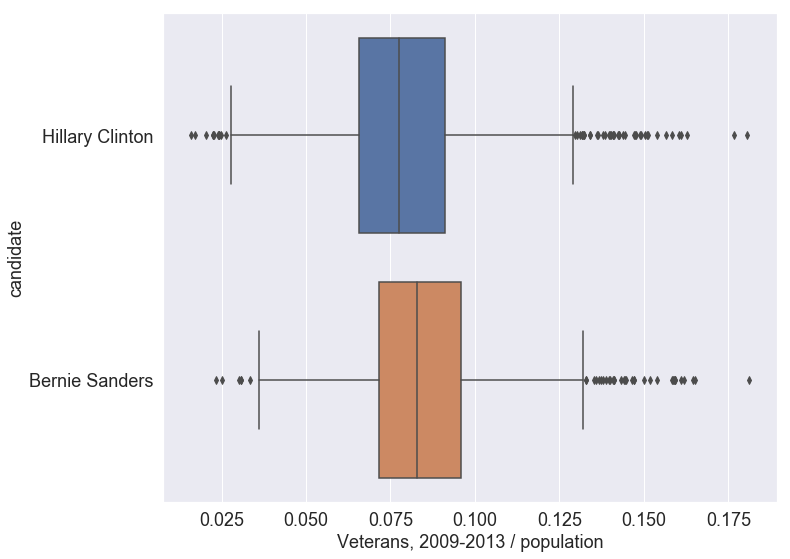

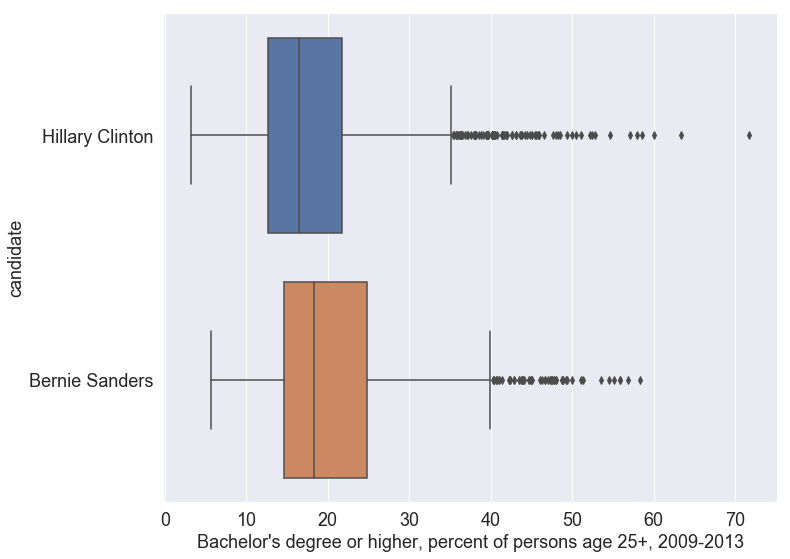

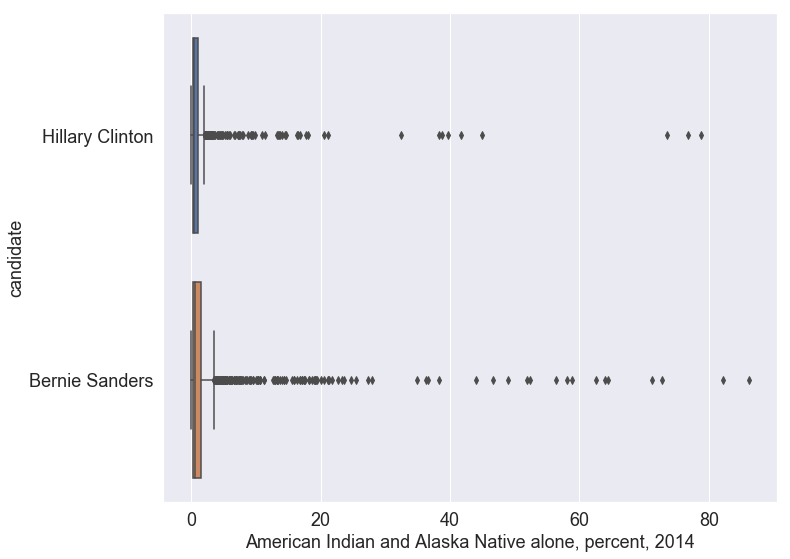

In [77]:
figsize = (11, 9)
for col in corr.keys()[indices[:topN:]]:
    plt.figure(figsize=figsize)
    sns.boxplot(y='candidate', x=col, orient='h', data=data)
    plt.xlabel(county_facts_dict.get(col, col))
    plt.show()

Из графиков выше можно выделить следующие зависимости:
* Берни Сандерс пользуется популярностью у белокожего населения, в то время как Хиллари Клинтон имеет хороший отрыв в остальных расах
* Однако там, где высока доля принадлежащих 2м и более расам, Сандерс побеждает (видимо один из родителей белый)
* Важным признаком является доля людей, закончивших старшую школу/университет. Сандерс имеет поддержку с их стороны
* Также играет роль доля несельскохозяйственных организаций. Чем больше - тем больше доля Сандерса
* За Хиллари Клинтон голосует много людей с доходом ниже прожиточного минимума
* В округах, голосовавших за Сандерса, средний размер семьи ниже. Возможно это связано с расовым составом

## Обучим модель

In [15]:
import lightgbm as lgb

In [27]:
X = data[data.columns[3:-2]].values
dataset = lgb.Dataset(X, label=y, feature_name=list(data.columns[3:-2].values))
y = (data['candidate'] == 'Hillary Clinton').values.astype(int)
params = {
    'objective': 'binary',
    'num_threads': 4
}
model = lgb.train(params, dataset)

Считаем важность по *gain*

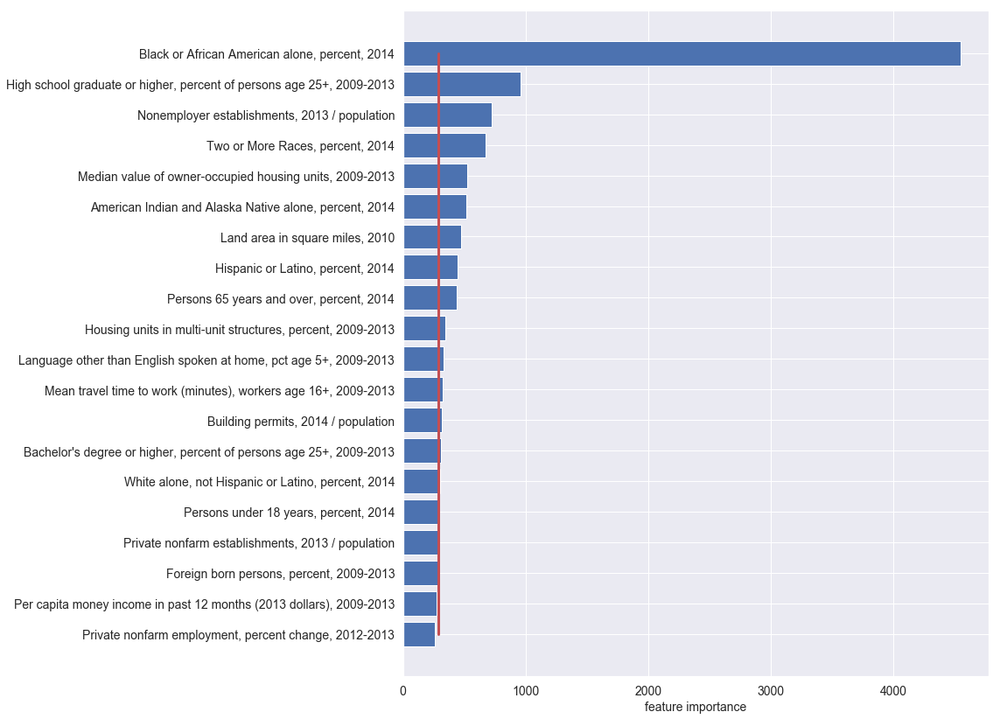

In [60]:
feature_importance = model.feature_importance(importance_type='gain')
indices2 = np.argsort(feature_importance)[::-1]
plt.figure(figsize=(12, 14))
topN = 20
plt.barh(np.arange(topN), feature_importance[indices2[topN - 1::-1]])
plt.plot([np.mean(feature_importance)] * topN, np.arange(topN), c='r', linewidth=3)
plt.yticks(np.arange(topN), [county_facts_dict.get(key, key) for key in data.columns[3:-2][indices2[topN - 1::-1]]])
plt.xlabel('feature importance')
plt.show()

Считаем важность по числу встреч в разбиениях

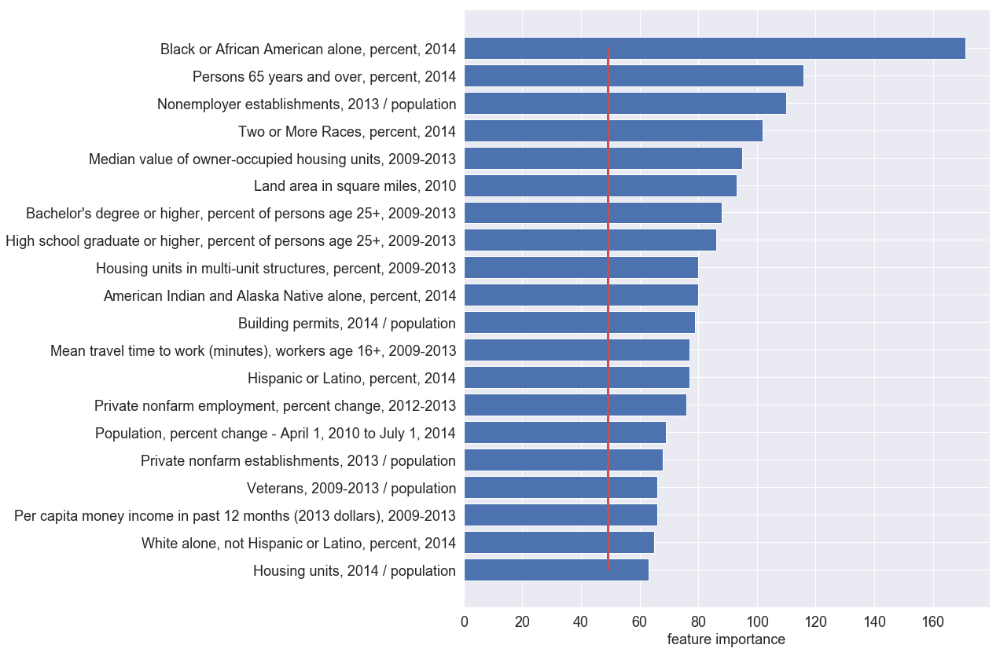

In [78]:
feature_importance = model.feature_importance()
indices2 = np.argsort(feature_importance)[::-1]
plt.figure(figsize=(12, 14))
topN = 20
plt.barh(np.arange(topN), feature_importance[indices2[topN - 1::-1]])
plt.plot([np.mean(feature_importance)] * topN, np.arange(topN), c='r', linewidth=3)
plt.yticks(np.arange(topN), [county_facts_dict.get(key, key) for key in data.columns[3:-2][indices2[topN - 1::-1]]])
plt.xlabel('feature importance')
plt.show()

Проверим признаки, показавшие важность.

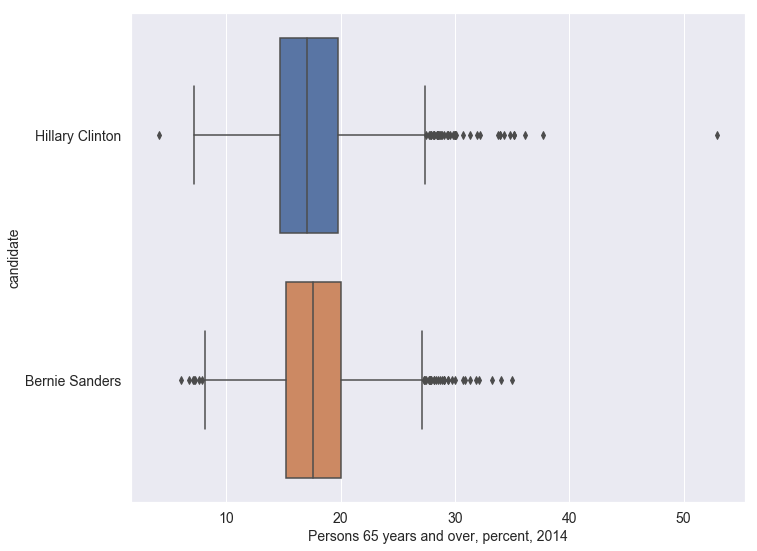

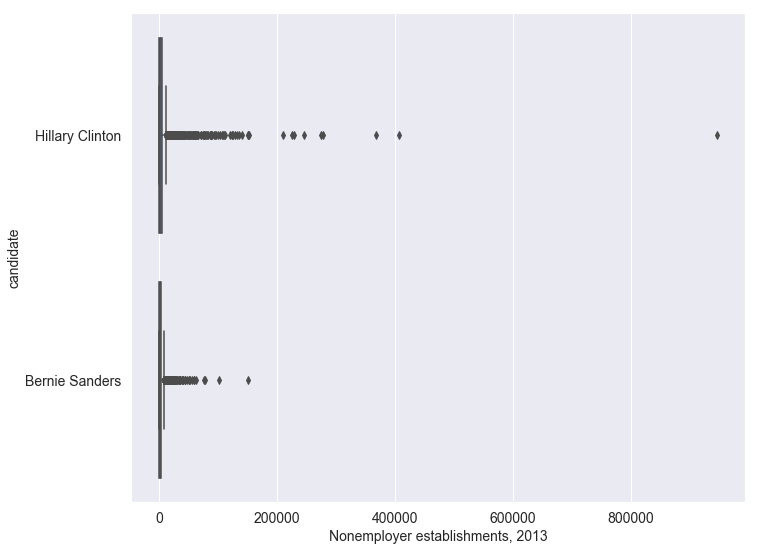

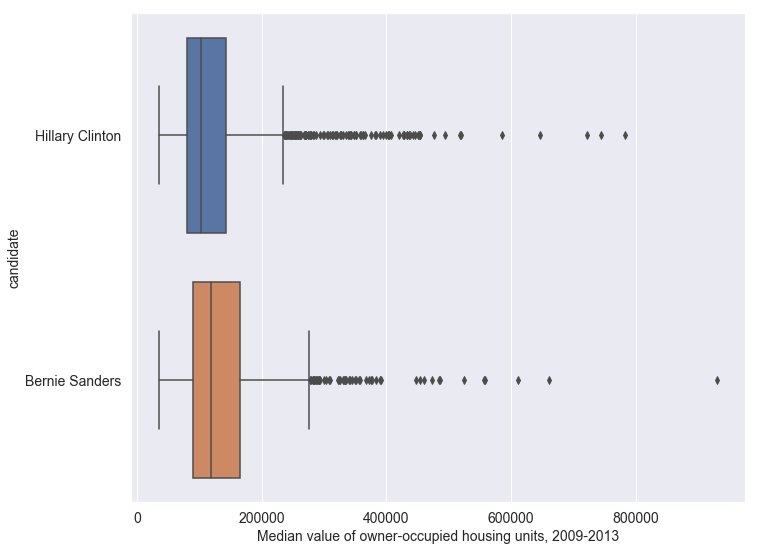

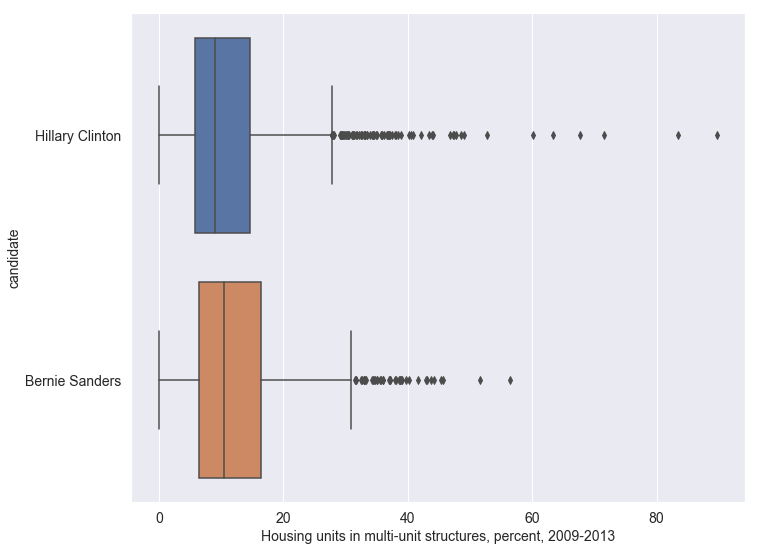

In [66]:
figsize = (11, 9)
for col in ['AGE775214', 'NES010213', 'HSG495213', 'HSG096213']:
    plt.figure(figsize=figsize)
    sns.boxplot(y='candidate', x=col, orient='h', data=data)
    plt.xlabel(county_facts_dict.get(col, col))
    plt.show()

Можно заметить, что:
* Медианная стоимость жилья в округах, голосовавших за Сандерса, выше, но максимальных значений она достигает в округах Клинтон
* Жилье в округах, голосовавших за Сандерса, "многоквартирнее"

# Попарные зависимости

Визуализируем топ по корреляции

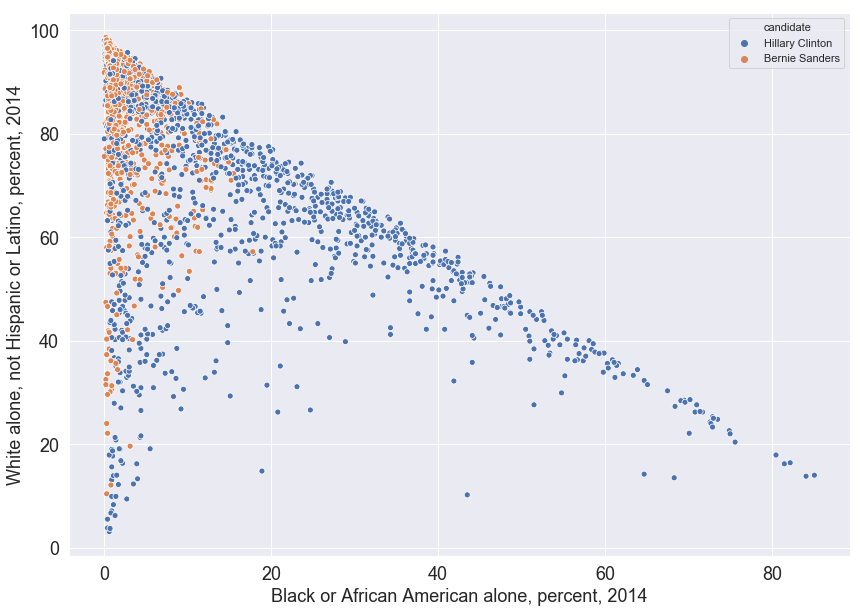

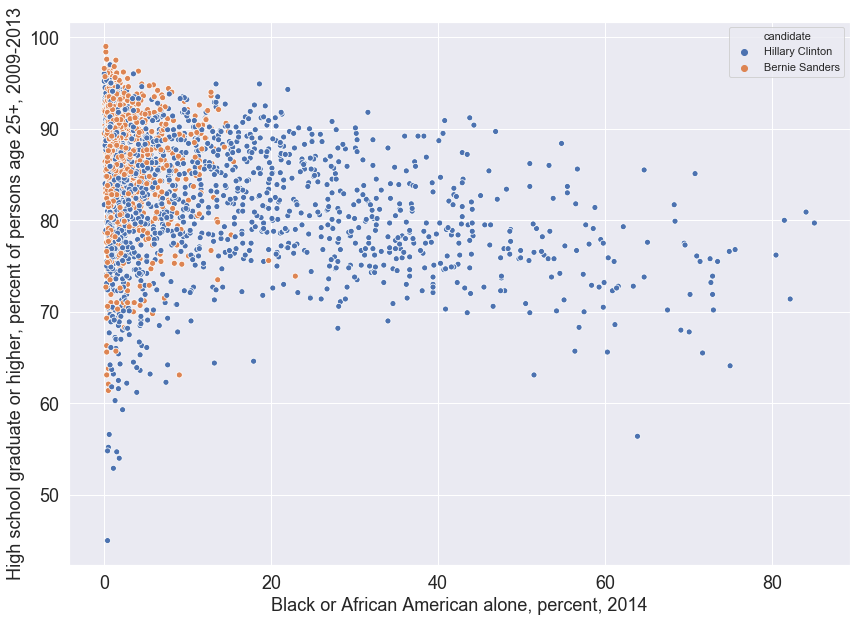

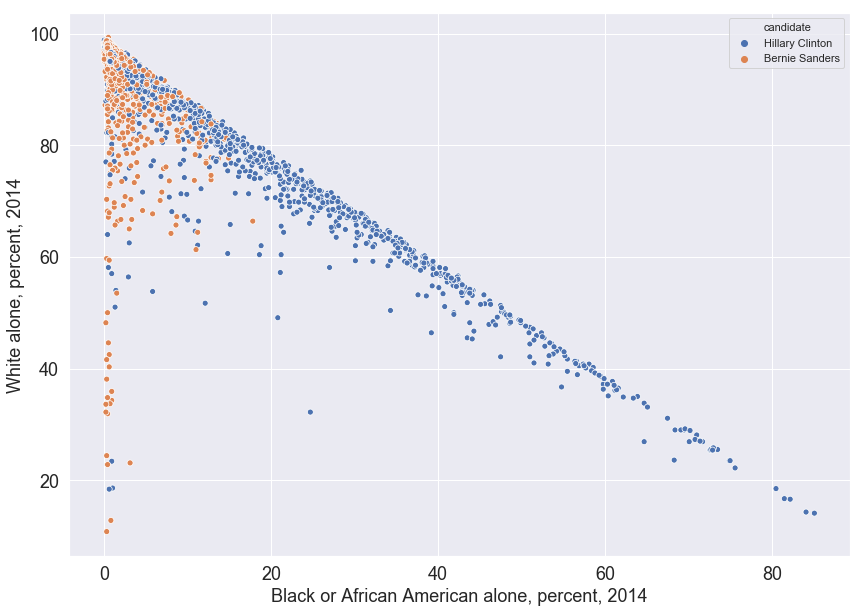

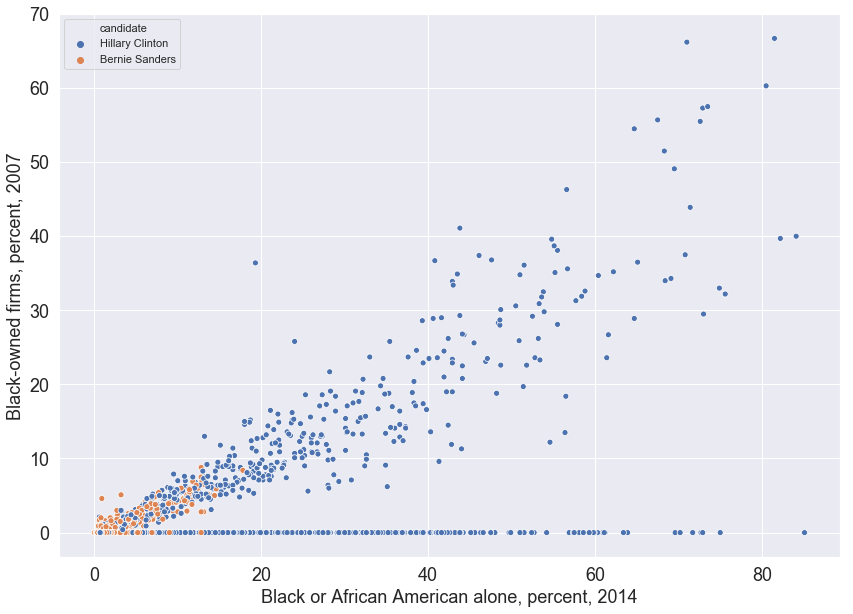

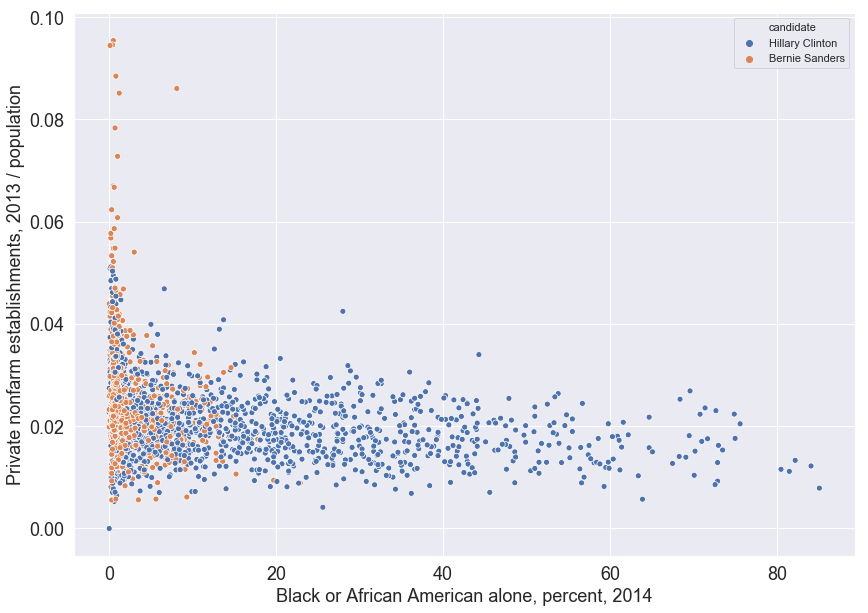

...

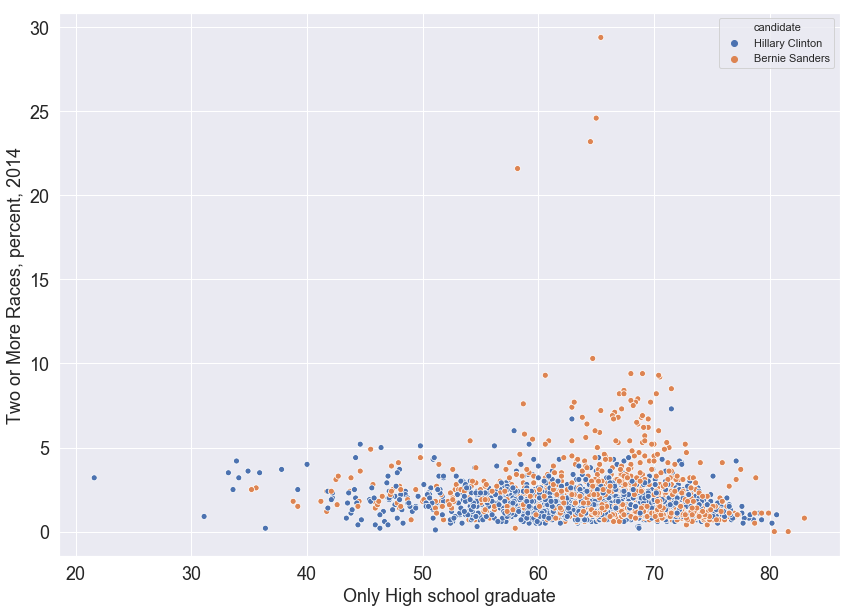

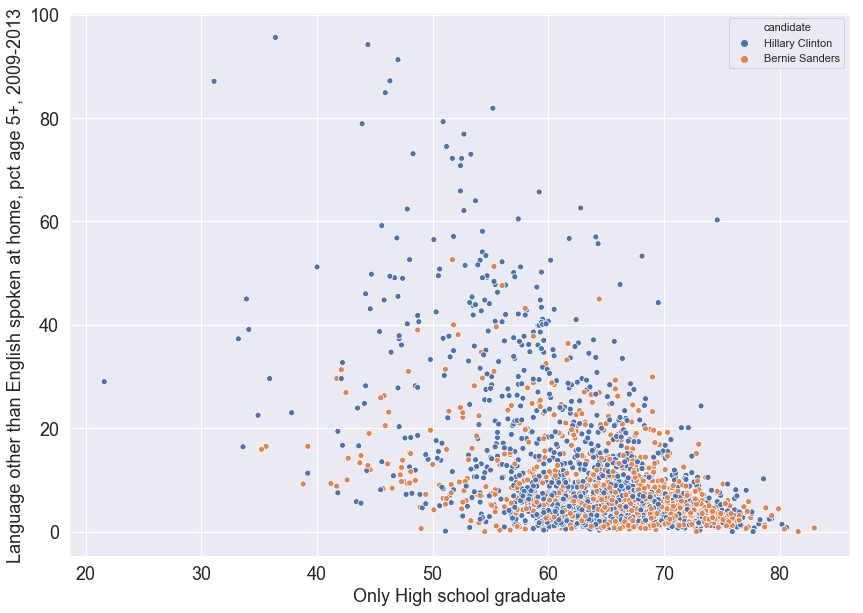

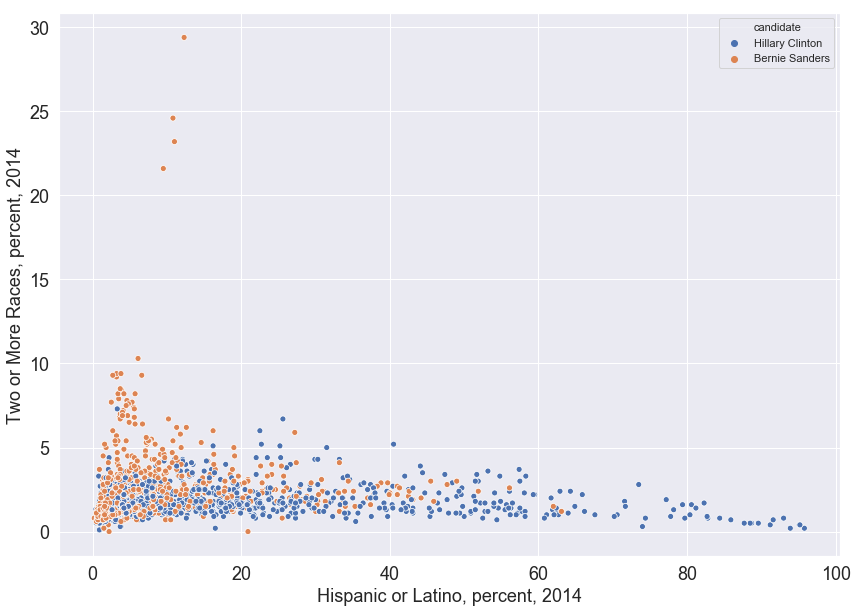

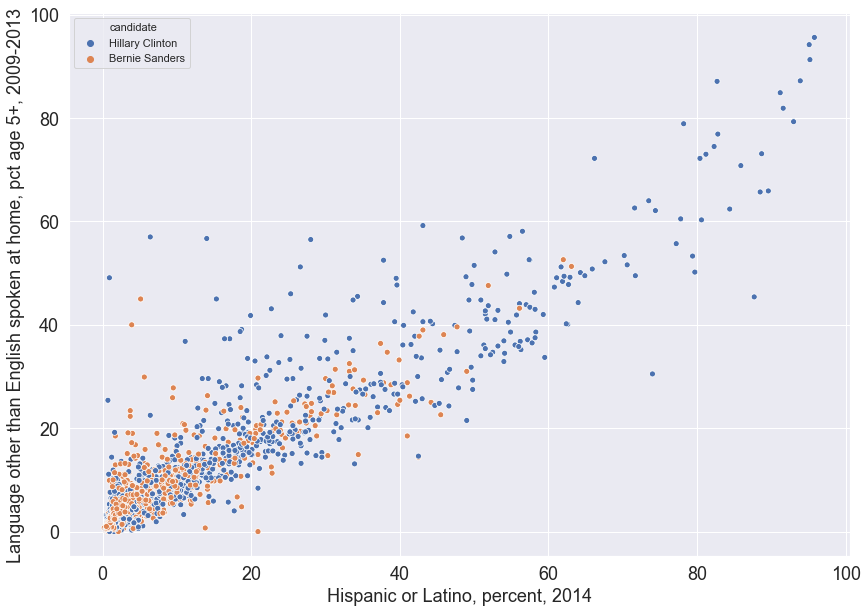

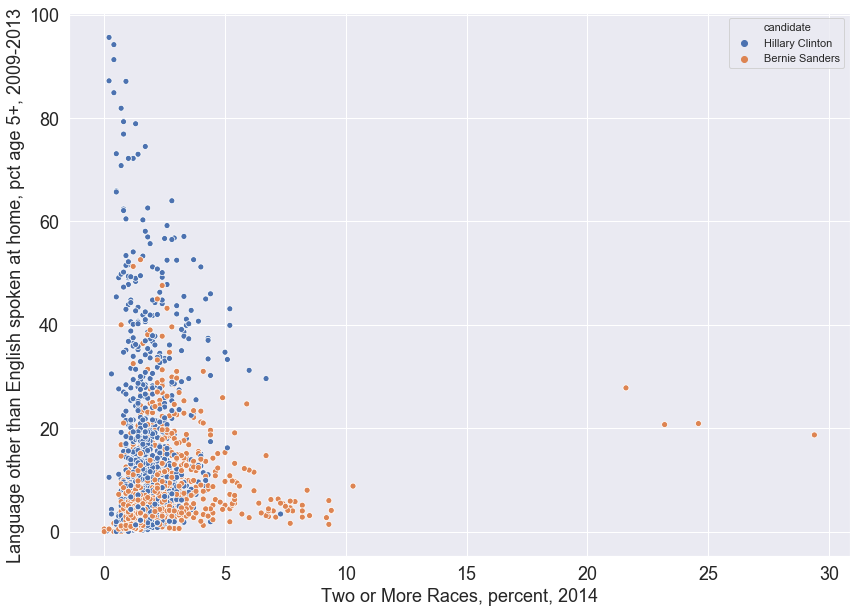

In [79]:
sorted_cols = corr.keys()[indices]
for i in range(0, 12):
    for j in range(i + 1, 13):
        plt.figure(figsize=(14, 10))
        sns.scatterplot(sorted_cols[i], sorted_cols[j], hue='candidate', data=data)
        plt.xlabel(county_facts_dict.get(sorted_cols[i], sorted_cols[i]))
        plt.ylabel(county_facts_dict.get(sorted_cols[j], sorted_cols[j]))
        plt.show()

Визуализируем топ по feature_importance (split_number)

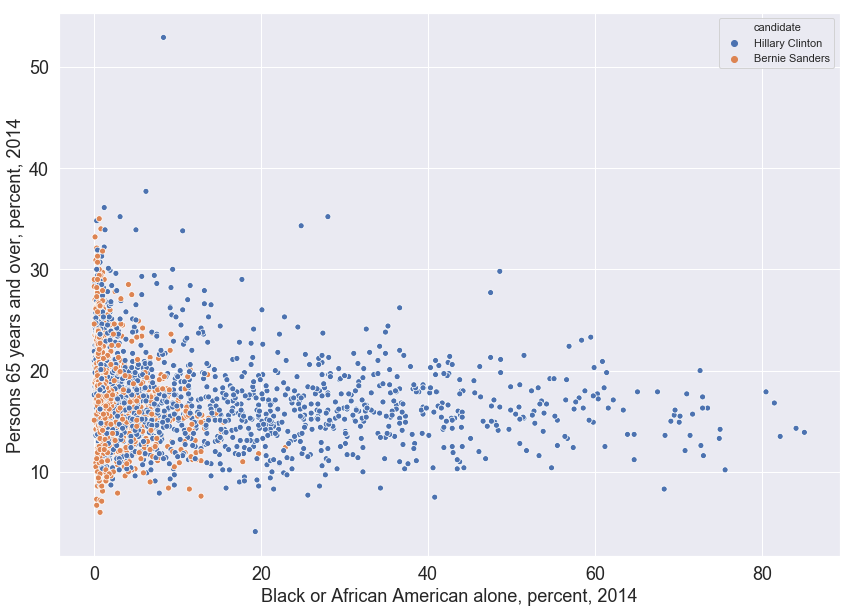

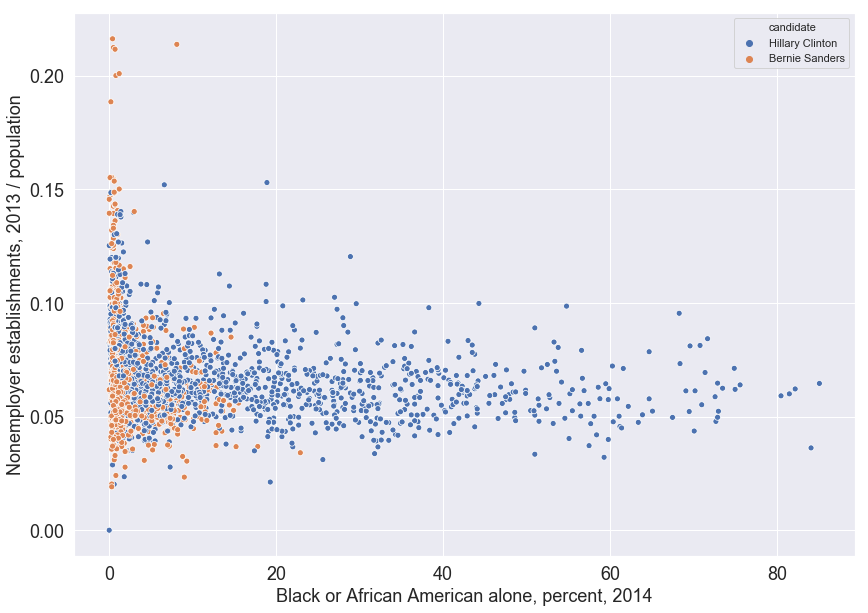

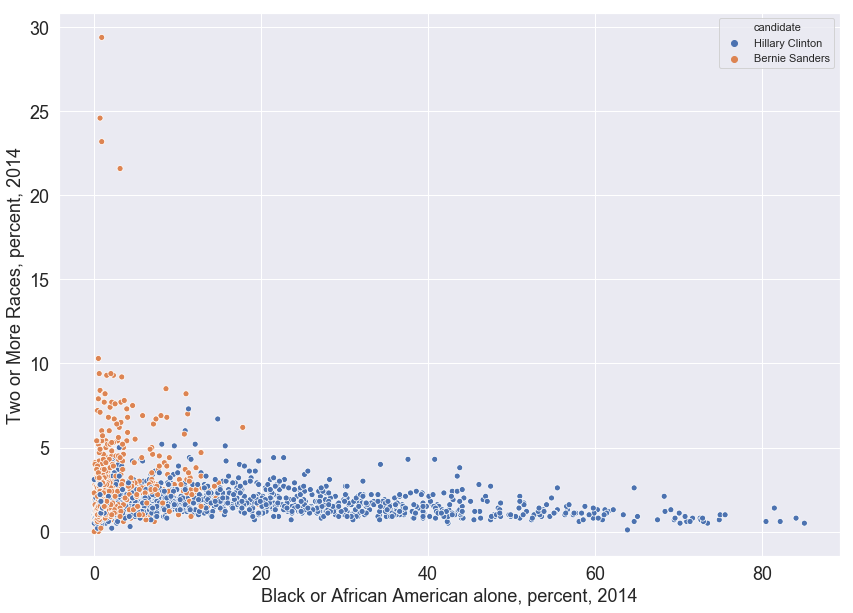

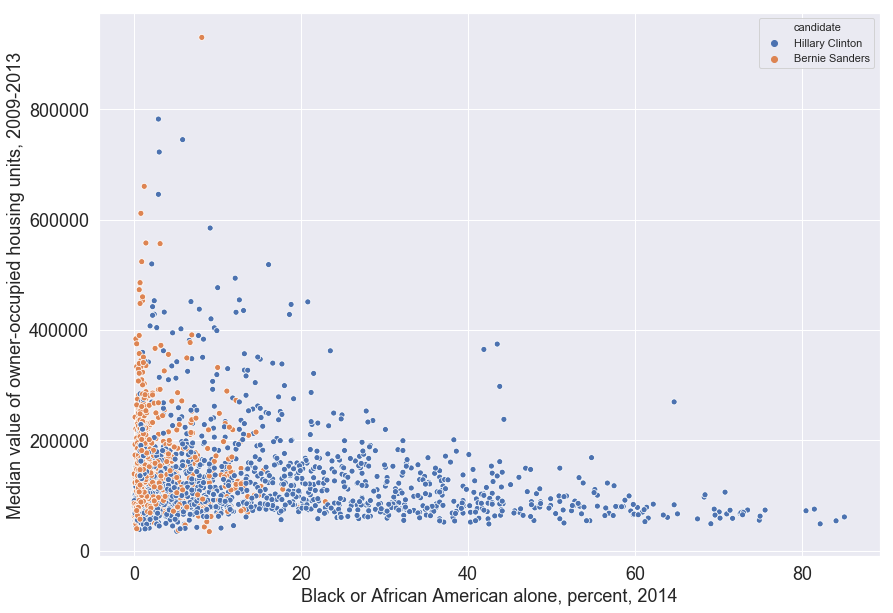

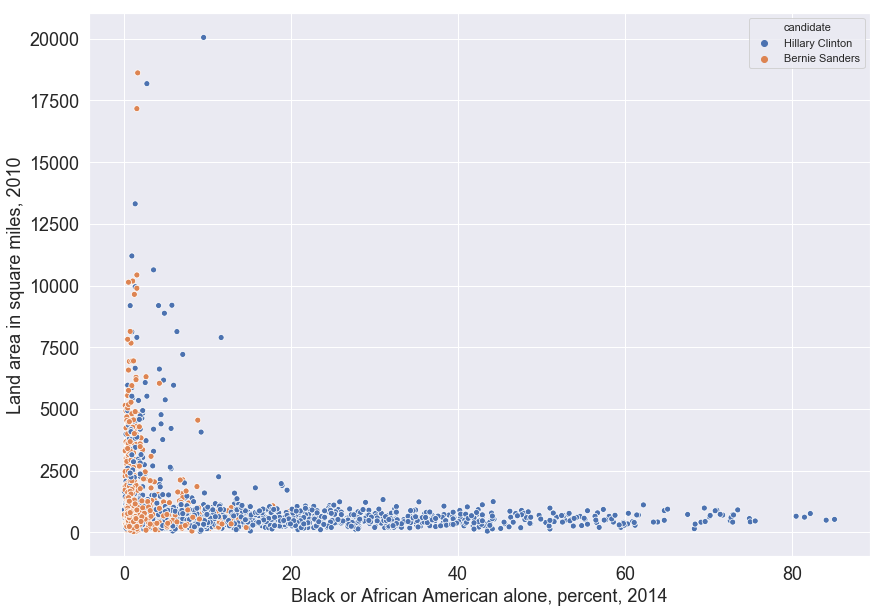

...

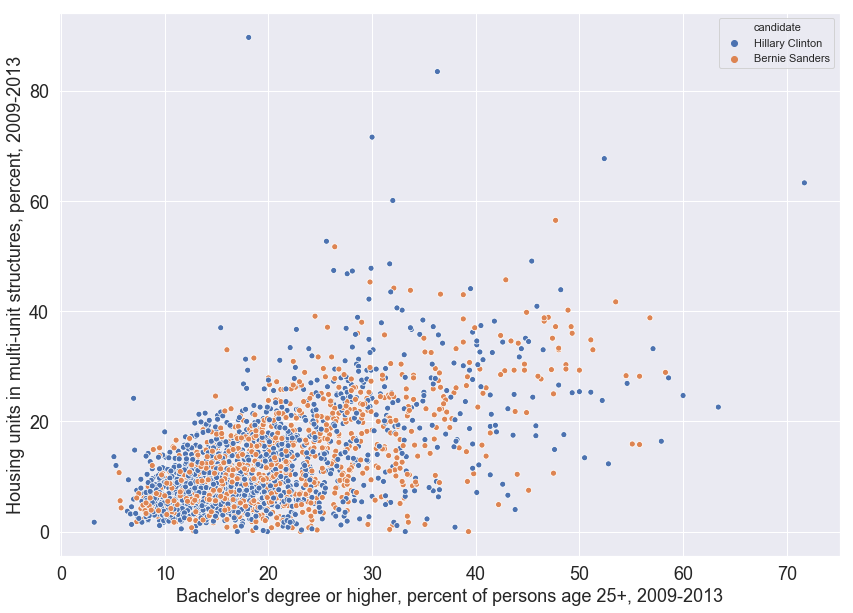

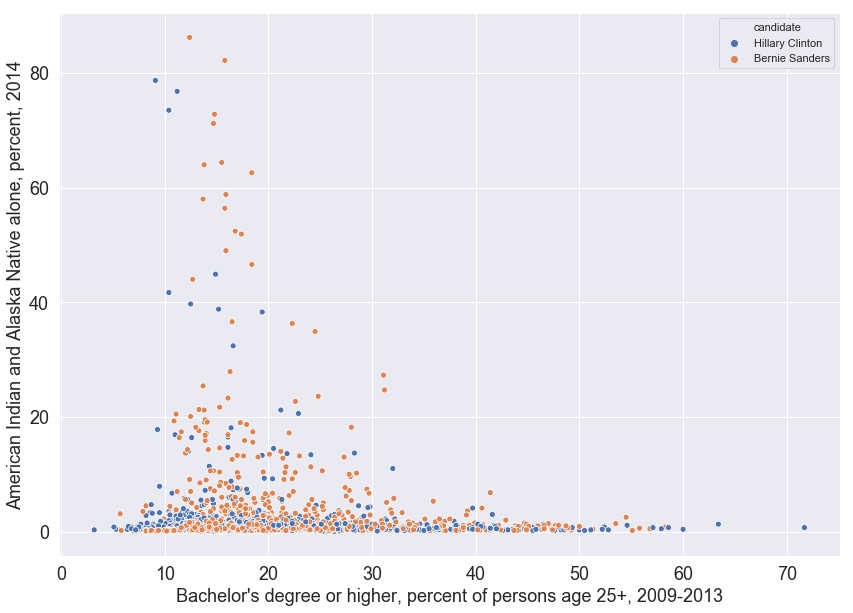

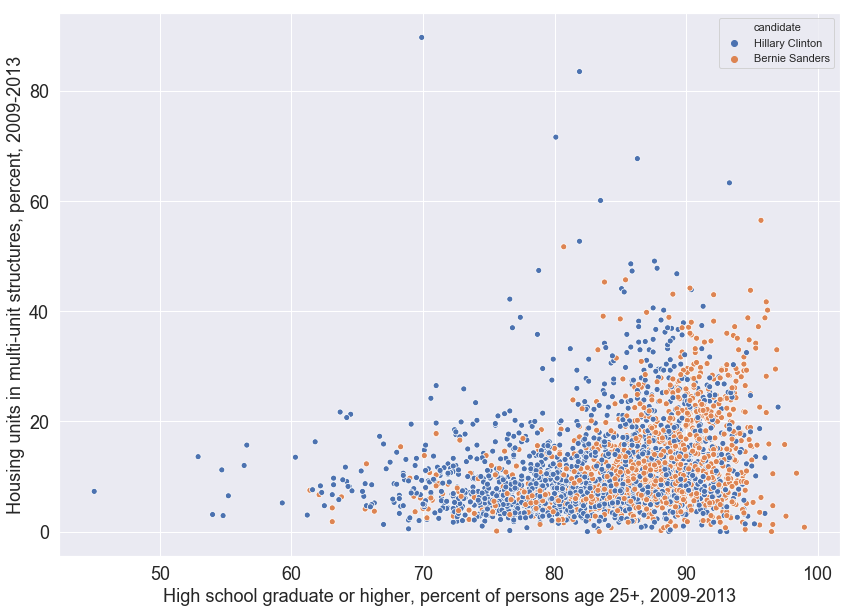

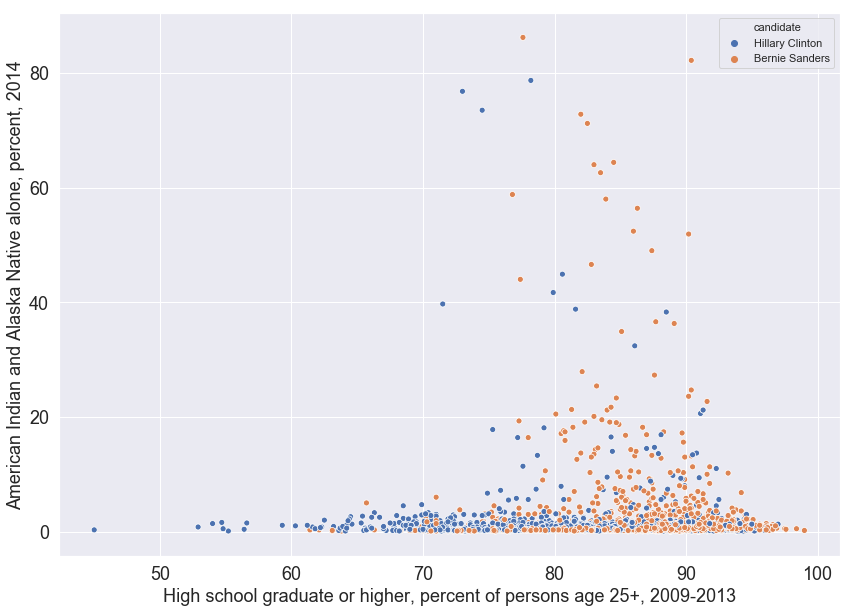

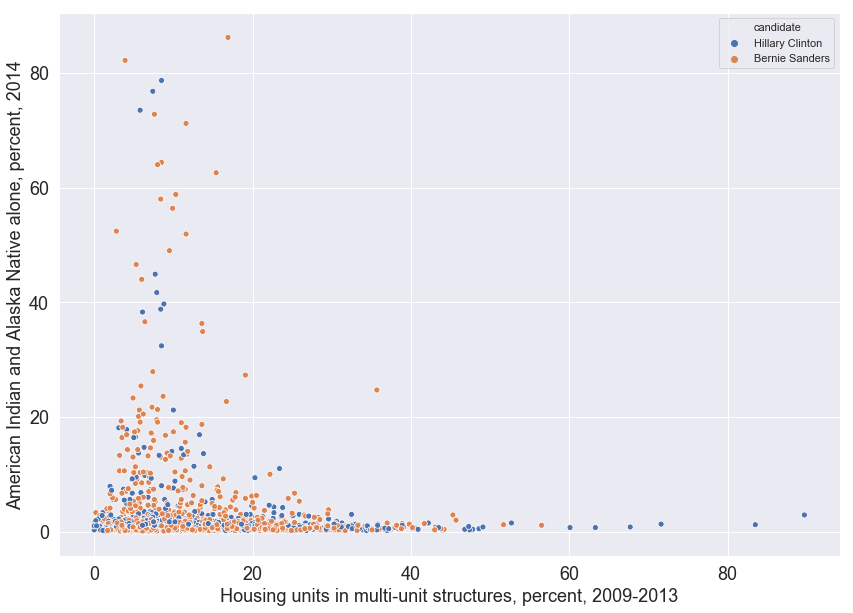

In [80]:
sorted_cols = data.columns[3:-2][indices2]
for i in range(0, 9):
    for j in range(i + 1, 10):
        plt.figure(figsize=(14, 10))
        sns.scatterplot(sorted_cols[i], sorted_cols[j], hue='candidate', data=data)
        plt.xlabel(county_facts_dict.get(sorted_cols[i], sorted_cols[i]))
        plt.ylabel(county_facts_dict.get(sorted_cols[j], sorted_cols[j]))
        plt.show()

То же самое, но с помощью jointplot

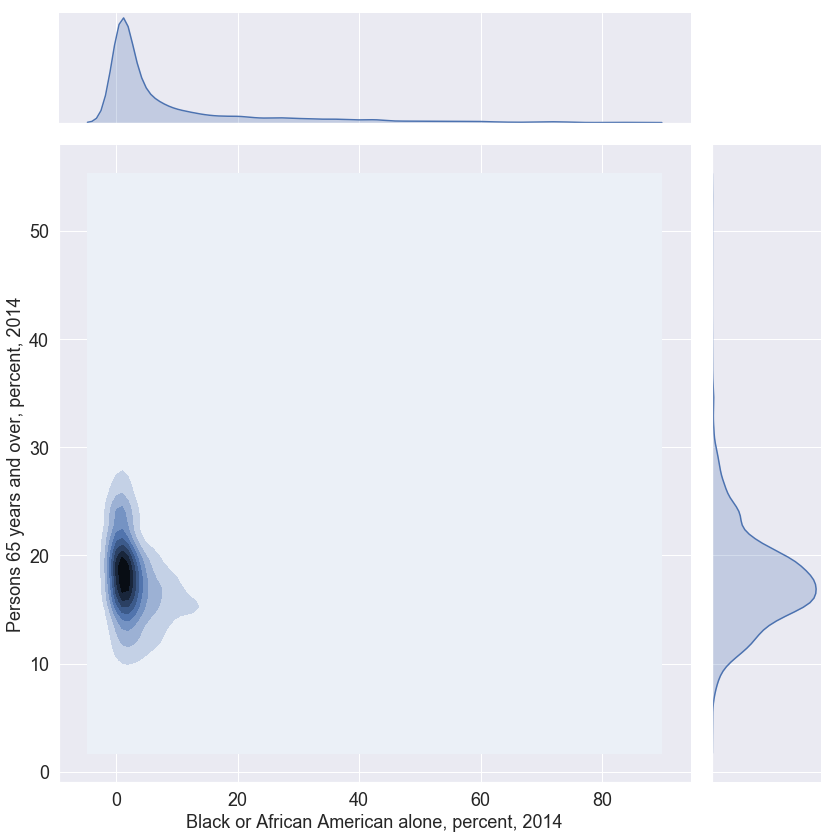

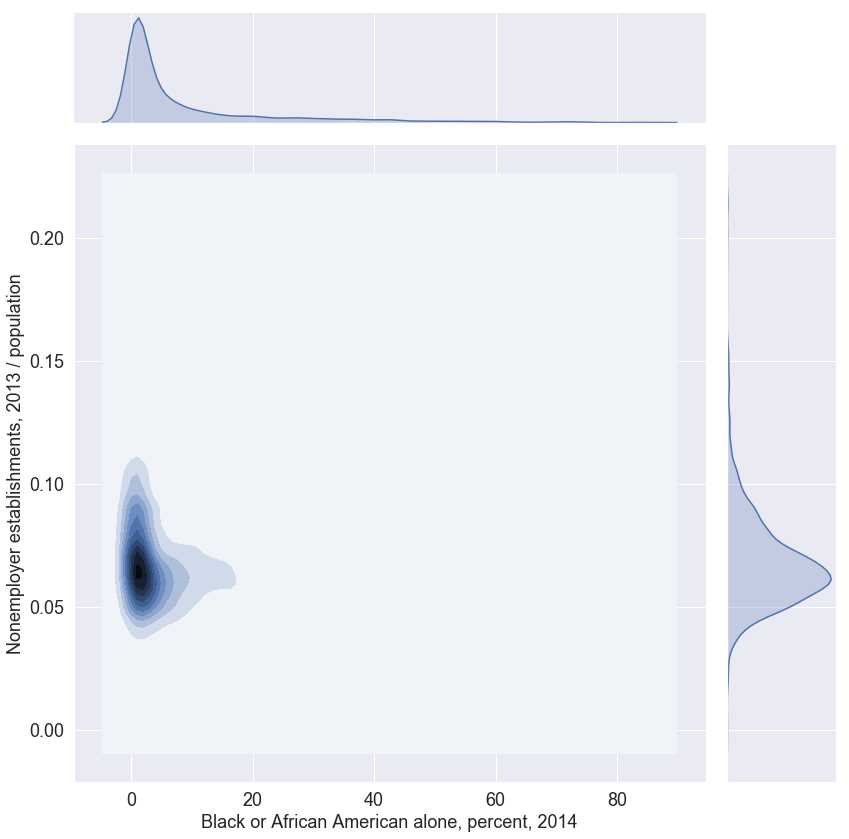

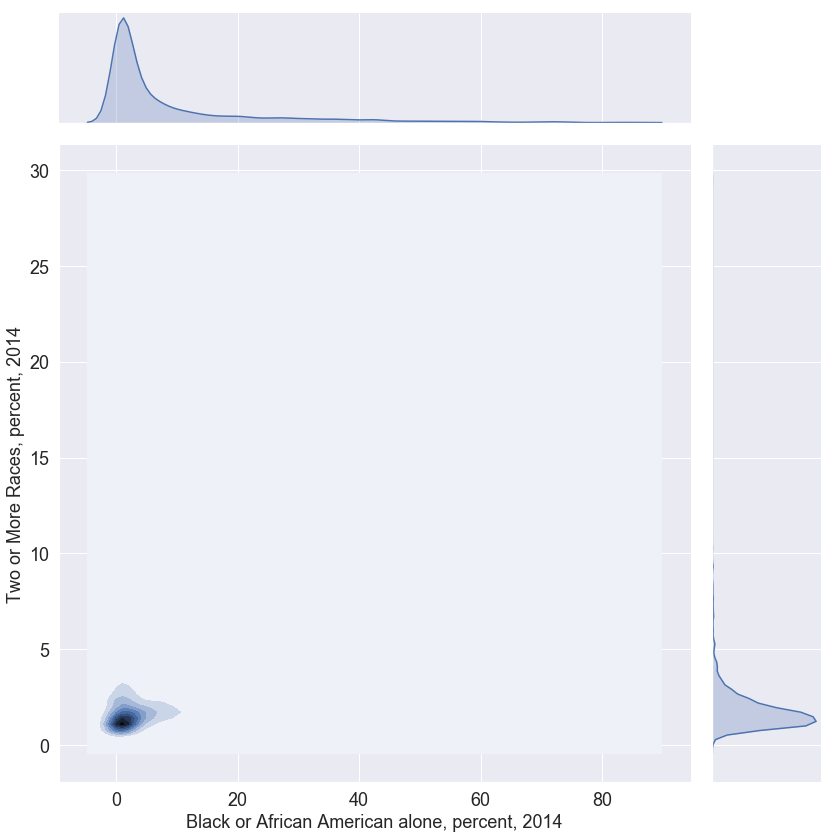

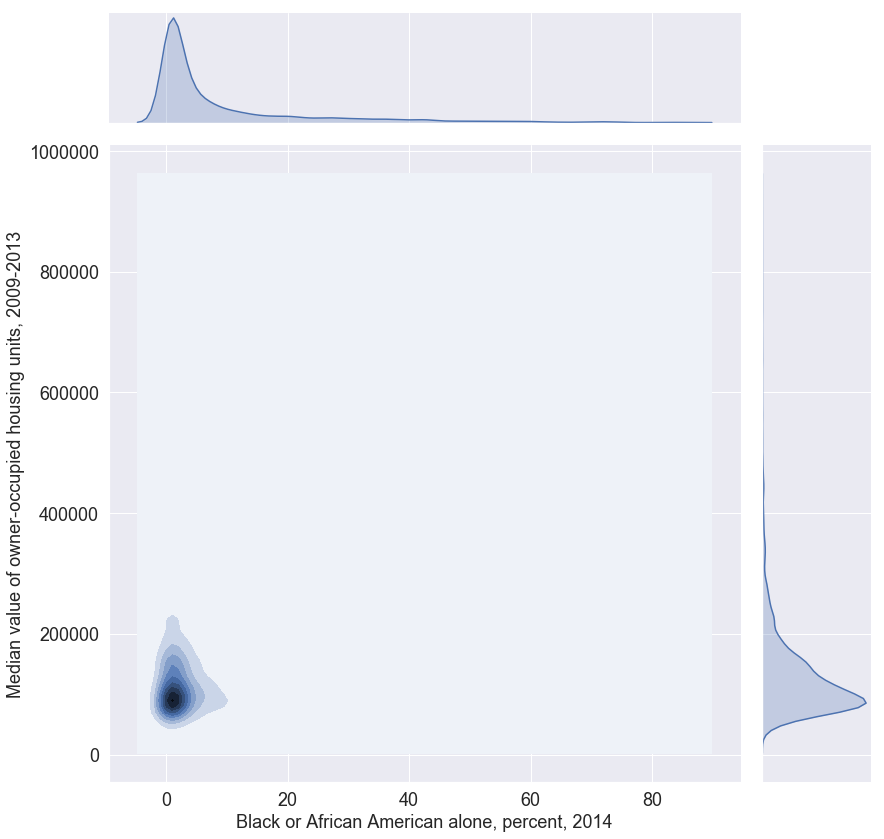

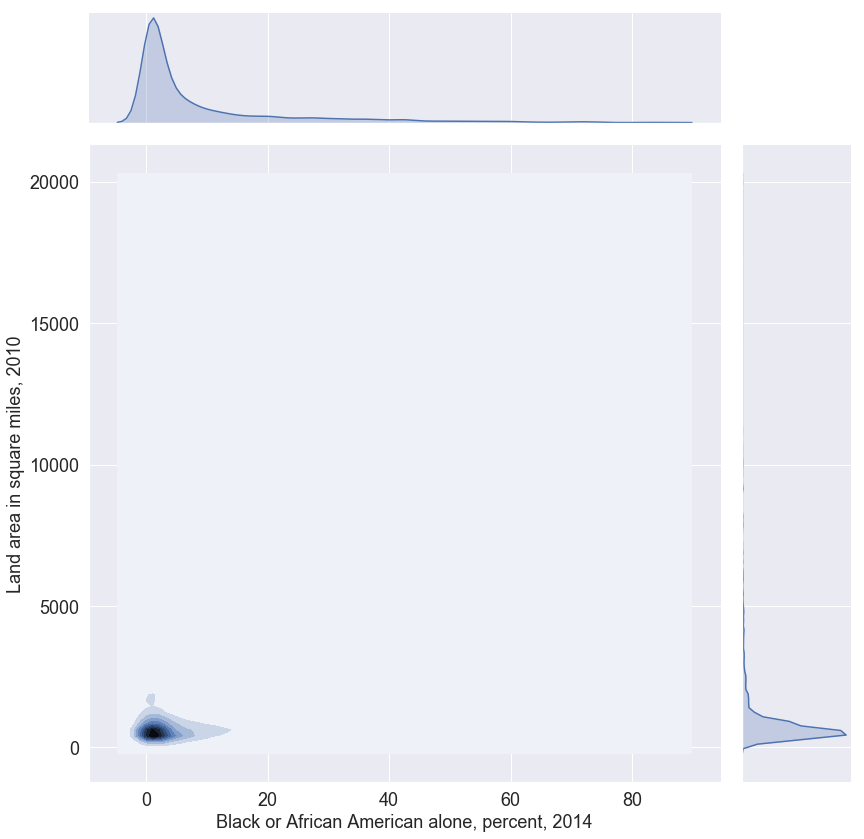

...

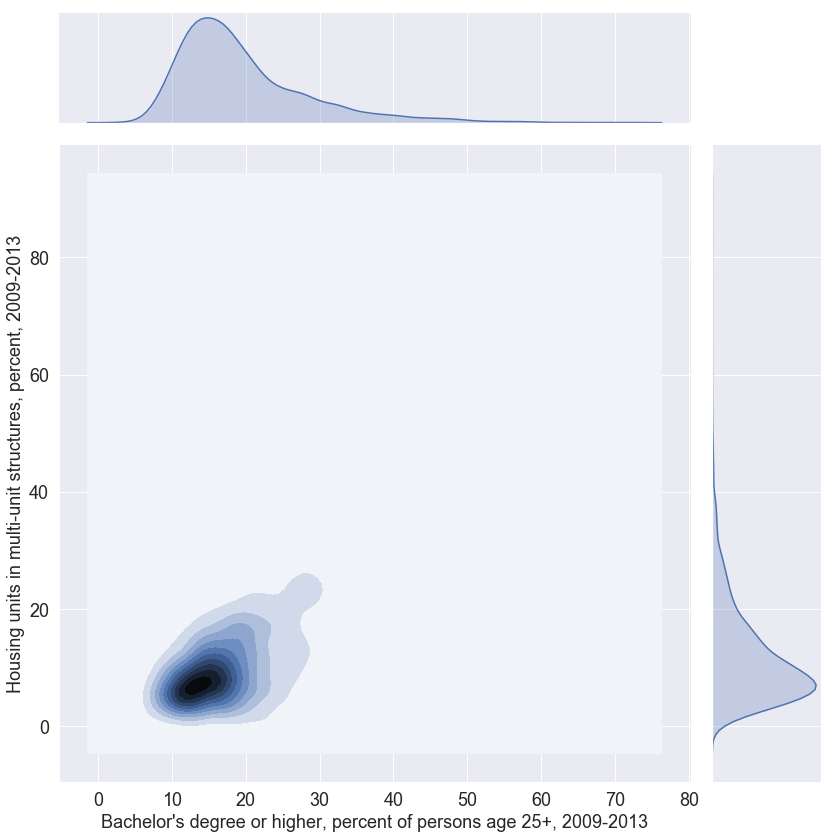

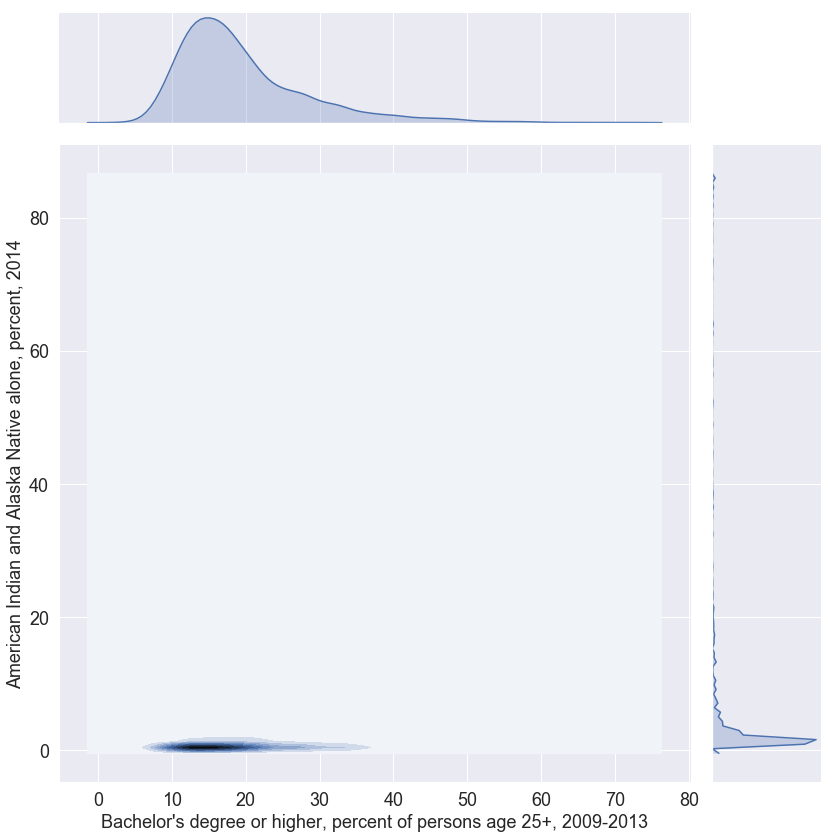

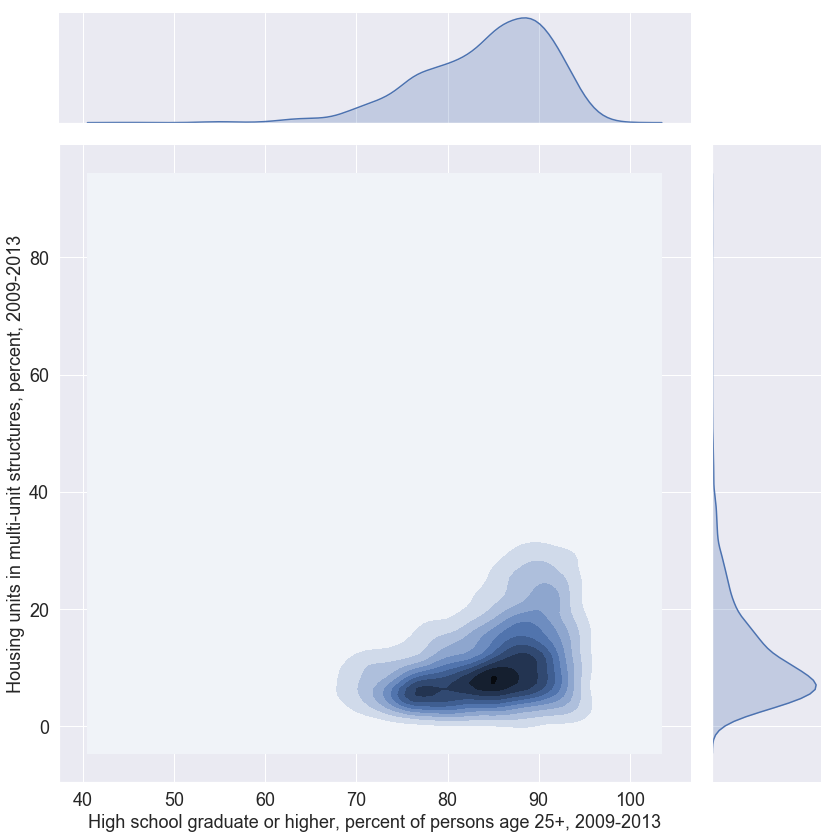

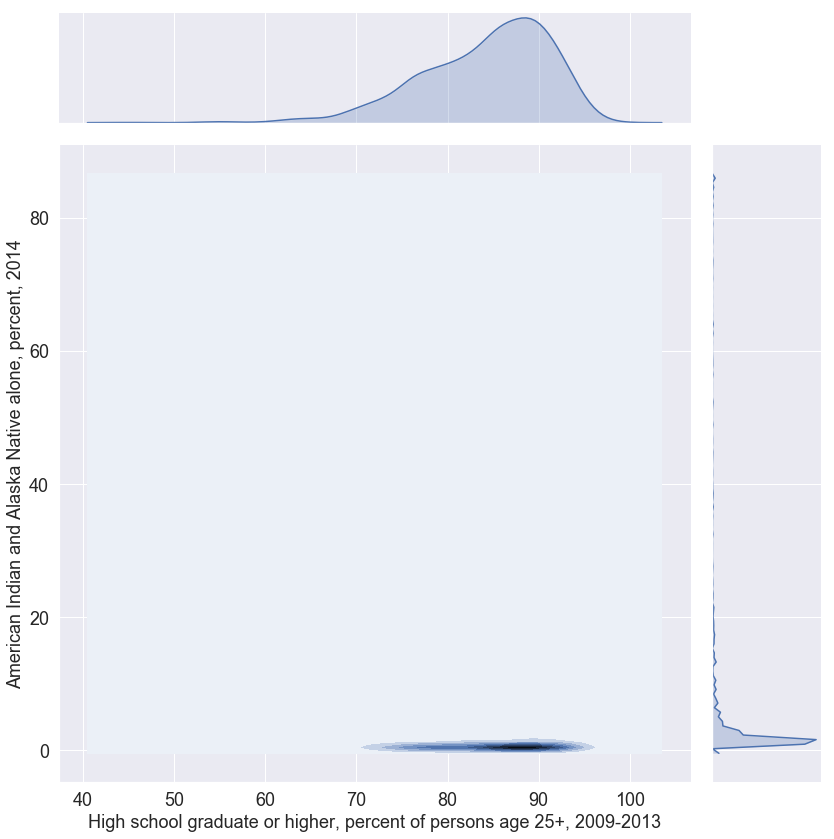

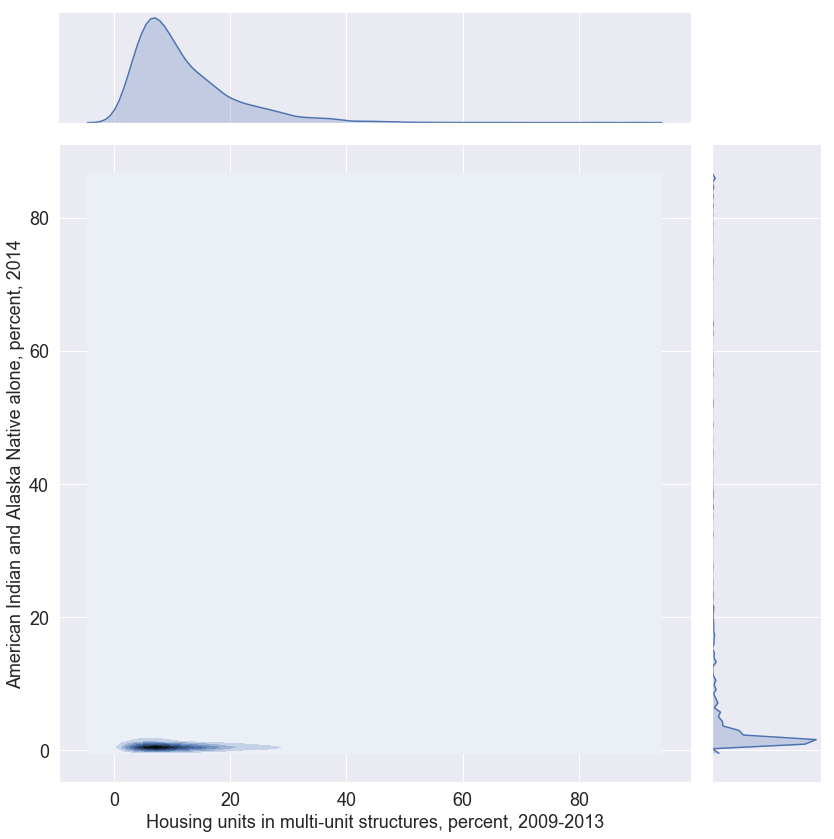

In [83]:
sorted_cols = data.columns[3:-2][indices2]
for i in range(0, 9):
    for j in range(i + 1, 10):
        # plt.figure(figsize=(14, 10))
        f = sns.jointplot(x=sorted_cols[i], y=sorted_cols[j], data=data, kind="kde", height=12)
        f.ax_joint.set_xlabel(county_facts_dict.get(sorted_cols[i], sorted_cols[i]))
        f.ax_joint.set_ylabel(county_facts_dict.get(sorted_cols[j], sorted_cols[j]))
        plt.show()

Что видно из графиков, чего не было видно раньше:
* В округах Клинтон доля людей за чертой бедности коррелирует с долей чернокожих людей (а также с долей испаноязычных жителей)
* В округах с преобладанием белокожих размер семьи уменьшается
* У образованных меньше риск попасть за черту бедности
* Доля людей с высшим образованием уменьшается с увеличением доли пожилых людей
* Пожилые люди предпочитают жить в малоквартирных домах
* Доля людей с высшим образованием зависит прямо пропорционально от доли ИП
* Доля людей с двумя корнями растет с увеличением доли высшего образования (видимо их больше в крупных городах)